# AI Comic Book Generator

In [1]:
!pip install torch torchvision diffusers transformers accelerate sentencepiece pillow

In [2]:
import os
from google.colab import userdata

# Retrieve the Hugging Face token from Colab secrets
# Make sure you have added your token under the name 'HF_TOKEN' in the Colab secrets panel (key icon on the left).
HF_TOKEN = userdata.get('HF_TOKEN')

# Set the token as an environment variable so Hugging Face libraries can find it
os.environ['HF_TOKEN'] = HF_TOKEN

if HF_TOKEN:
    print("Hugging Face token successfully loaded from Colab secrets.")
else:
    print("WARNING: Hugging Face token (HF_TOKEN) not found in Colab secrets. Please add it.")

Hugging Face token successfully loaded from Colab secrets.


In [3]:
import torch
from diffusers import DiffusionPipeline

# switch to "mps" for apple devices
pipe = DiffusionPipeline.from_pretrained("ogkalu/Comic-Diffusion", dtype=torch.bfloat16, device_map="cuda")



Flax classes are deprecated and will be removed in Diffusers v1.0.0. We recommend migrating to PyTorch classes or pinning your version of Diffusers.
Flax classes are deprecated and will be removed in Diffusers v1.0.0. We recommend migrating to PyTorch classes or pinning your version of Diffusers.
/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:104: UserWarning: 
Error while fetching `HF_TOKEN` secret value from your vault: 'Requesting secret HF_TOKEN timed out. Secrets can only be fetched when running from the Colab UI.'.
You are not authenticated with the Hugging Face Hub in this notebook.
If the error persists, please let us know by opening an issue on GitHub (https://github.com/huggingface/huggingface_hub/issues/new).
  warnings.warn(
Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading weights:   0%|          | 0/196 [00:00<?, ?it/s]

CLIPTextModel LOAD REPORT from: /root/.cache/huggingface/hub/models--ogkalu--Comic-Diffusion/snapshots/ff684f581ab24e094e2055d9422e9ee076d139a8/text_encoder
Key                                | Status     |  | 
-----------------------------------+------------+--+-
text_model.embeddings.position_ids | UNEXPECTED |  | 

Notes:
- UNEXPECTED	:can be ignored when loading from different task/architecture; not ok if you expect identical arch.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--ogkalu--Comic-Diffusion/snapshots/ff684f581ab24e094e2055d9422e9ee076d139a8/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--ogkalu--Comic-Diffusion/snapshots/ff684f581ab24e094e2055d9422e9ee076d139a8/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Loading weights:   0%|          | 0/396 [00:00<?, ?it/s]

StableDiffusionSafetyChecker LOAD REPORT from: /root/.cache/huggingface/hub/models--ogkalu--Comic-Diffusion/snapshots/ff684f581ab24e094e2055d9422e9ee076d139a8/safety_checker
Key                                               | Status     |  | 
--------------------------------------------------+------------+--+-
vision_model.vision_model.embeddings.position_ids | UNEXPECTED |  | 

Notes:
- UNEXPECTED	:can be ignored when loading from different task/architecture; not ok if you expect identical arch.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--ogkalu--Comic-Diffusion/snapshots/ff684f581ab24e094e2055d9422e9ee076d139a8/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--ogkalu--Comic-Diffusion/snapshots/ff684f581ab24e094e2055d9422e9ee076d139a8/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


In [ ]:
import torch
from PIL import Image
from transformers import CLIPProcessor, CLIPModel

def get_panel_accuracy(image_path, panels_data, grid_size=(4, 3)):
    """
    grid_size: (rows, cols)
    """
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").to(device)
    processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

    
    full_image = Image.open(image_path)
    width, height = full_image.size

    
    panel_w = width // grid_size[1]
    panel_h = height // grid_size[0]

    report = []

    for i, panel in enumerate(panels_data):
       
        row = i // grid_size[1]
        col = i % grid_size[1]
        left = col * panel_w
        top = row * panel_h
        right = left + panel_w
        bottom = top + panel_h

        
        panel_img = full_image.crop((left, top, right, bottom))

        
        inputs = processor(text=[panel["prompt"]], images=panel_img, return_tensors="pt", padding=True).to(device)
        with torch.no_grad():
            outputs = model(**inputs)
            score = outputs.logits_per_image.item()

        
        status = "Excellent" if score > 30 else "Good" if score > 25 else "Needs Revision"
        report.append({"panel": i+1, "score": round(score, 2), "status": status})
        print(f"Panel {i+1}: Score {score:.2f} | {status}")

    return report




In [21]:
# 2. Story Data Definition: The Clockwork Alchemist
PANELS_DATA_Clockwork = [
    {"prompt": "Flying steampunk city floating above clouds, brass gears, steam exhausts, golden hour light, Western comic art style",
     "text": "Aetheria. The city where steam meets the stars.", "pos": "top"},

    {"prompt": "Alchemist Elara holding ancient copper compass, glowing runes on brass surface, close up, Western comic art style",
     "text": "The North Star is shifting... this shouldn't be possible.", "pos": "bottom"},

    {"prompt": "Elara in a Victorian workshop, cluttered with vials and gears, mysterious smoke rising, Western comic art style",
     "text": "Something is leaking from the Void. A breach in the gears of time.", "pos": "top"},

    {"prompt": "Mechanical shadow creature emerging from a bronze mirror, glowing red eyes, sharp metal claws, Western comic art style",
     "text": "You found it, Alchemist. The key to the Eternal Engine.", "pos": "top"},

    {"prompt": "Elara throwing a vial of glowing liquid, blue chemical explosion, defensive stance, Western comic art style",
     "text": "Back to the abyss, clockwork nightmare!", "pos": "bottom"},

    {"prompt": "Shadow creature shattering into cogs and bolts, metal sparks flying, high action, Western comic art style",
     "text": "It was just a scout... more are coming.", "pos": "top"},

    {"prompt": "Elara looking at her compass, needle spinning wildly, magical distortion, Western comic art style",
     "text": "The entire city is losing its gravitational balance!", "pos": "bottom"},

    {"prompt": "Captain Thorne landing on the balcony, mechanical wings folding, goggles on head, Western comic art style",
     "text": "Elara! The main engine is stalling. We need that compass.", "pos": "top"},

    {"prompt": "Thorne and Elara looking at a giant gear-driven portal opening in sky, Western comic art style",
     "text": "The sky is cracking open... that's ancient magic tech.", "pos": "bottom"},

    {"prompt": "Elara picking up a glowing crystalline gear from the floor, close up, magical aura, Western comic art style",
     "text": "The creature dropped a fragment. A piece of the celestial core.", "pos": "top"},

    {"prompt": "Elara slotting the crystal gear into her compass, interface glowing gold, Western comic art style",
     "text": "Let's calibrate the timeline. One gear at a time.", "pos": "bottom"},

    {"prompt": "Elara and Thorne standing on edge of airship, looking at the portal, determined, Western comic art style",
     "text": "Aetheria will not fall today. Not on my watch.", "pos": "top"}
]

In [8]:
# 3. Speech Bubble Logic
def add_speech_bubble(image, text, position_type='top'):
    draw = ImageDraw.Draw(image)
    width, height = image.size

    try:
        # Use a common system font path for Linux/Colab
        font_path = "/usr/share/fonts/truetype/liberation/LiberationSans-Bold.ttf"
        if not os.path.exists(font_path): font_path = "DejaVuSans-Bold.ttf"
        font = ImageFont.truetype(font_path, 36)
    except:
        font = ImageFont.load_default()

    max_chars_per_line = 22
    lines = []
    words = text.split()
    current_line = ""
    for word in words:
        if len(current_line) + len(word) + 1 <= max_chars_per_line:
            current_line += (word + " ")
        else:
            lines.append(current_line.strip())
            current_line = word + " "
    lines.append(current_line.strip())
    wrapped_text = "\n".join(lines)

    bbox = draw.textbbox((0, 0), wrapped_text, font=font)
    text_w, text_h = bbox[2] - bbox[0], bbox[3] - bbox[1]
    padding = 20
    bubble_w, bubble_h = text_w + padding * 2, text_h + padding * 2

    if position_type == 'top':
        bx, by = (width - bubble_w) // 2, 40
        tail_dir = 'down'
    else:
        bx, by = (width - bubble_w) // 2, height - bubble_h - 120
        tail_dir = 'up'

    draw.rounded_rectangle([bx, by, bx + bubble_w, by + bubble_h], radius=25, fill="white", outline="black", width=4)

    if tail_dir == 'down':
        tail_pts = [(bx + bubble_w//2, by + bubble_h), (bx + bubble_w//2 + 15, by + bubble_h + 25), (bx + bubble_w//2 - 15, by + bubble_h)]
    else:
        tail_pts = [(bx + bubble_w//2, by), (bx + bubble_w//2 + 15, by - 25), (bx + bubble_w//2 - 15, by)]

    draw.polygon(tail_pts, fill="white", outline="black")
    if tail_dir == 'down':
        draw.line([(bx + bubble_w//2 - 13, by + bubble_h), (bx + bubble_w//2 + 13, by + bubble_h)], fill="white", width=4)
    else:
        draw.line([(bx + bubble_w//2 - 13, by), (bx + bubble_w//2 + 13, by)], fill="white", width=4)

    draw.multiline_text((bx + padding, by + padding), wrapped_text, font=font, fill="black", align="center")
    return image

In [1]:
# 4. Generate and Assemble Comic
def generate_and_assemble_comic(panels_data):
  generated_panels = []
  for i, data in enumerate(panels_data):
      print(f"Generating Panel {i+1}...")
      # Generate image with FLUX + LoRA
      image = pipe(data["prompt"], num_inference_steps=30, guidance_scale=7.5).images[0]
      image = image.resize((1024, 1024))

      # Add speech bubble
      panel_with_text = add_speech_bubble(image, data["text"], data["pos"])
      generated_panels.append(panel_with_text)

      # Optional: Save individual panels
      panel_with_text.save(f"panel_{i+1}.png")

  # Grid Layout (3x4)
  pw, ph = 1024, 1024
  margin = 25
  page_w = pw * 3 + margin * 4
  page_h = ph * 4 + margin * 5
  final_page = Image.new('RGB', (page_w, page_h), color='black')

  for i, panel in enumerate(generated_panels):
      col, row = i % 3, i // 3
      final_page.paste(panel, (margin + col * (pw + margin), margin + row * (ph + margin)))

  final_page.save("final_comic_flux.png")
  final_page.show()
  print("Comic Generation Complete!")
  return final_page

In [20]:
generate_and_assemble_comic(PANELS_DATA_Clockwork)

Generating Panel 1/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 2/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 3/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 4/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 5/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 6/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 7/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 8/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 9/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 10/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 11/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 12/12...


  0%|          | 0/30 [00:00<?, ?it/s]

Comic Generation Complete!


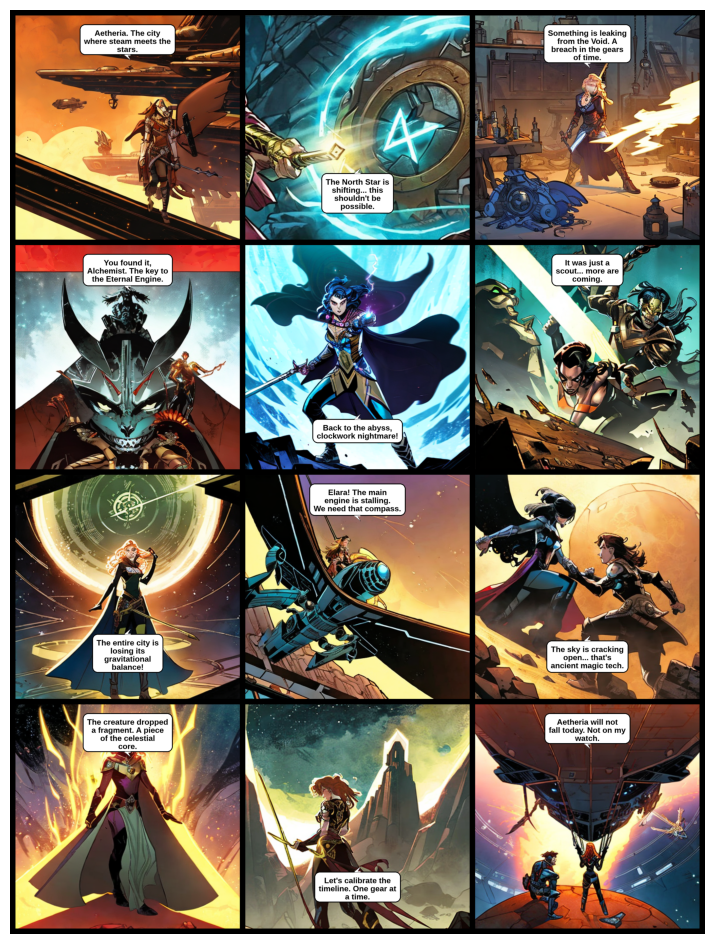

In [6]:
# show image

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
plt.figure(figsize=(12, 12))
img = mpimg.imread('world.png')

plt.imshow(img)
plt.axis('off') 
plt.show()


In [ ]:
# 2. Story Data Definition: The Cinder & Starlight
PANELS_DATA_Cinderella = [
    
    {"prompt": "Cinderella, cleaning a dark Victorian fireplace, cinematic lighting, gothic comic style",
     "text": "They call me Cinderella. A name born from the soot and dust.", "pos": "top"},
    {"prompt": "Cruel stepmother in purple velvet, holding a golden invitation, shadows on face, gothic comic style",
     "text": "The Royal Ball is for the pure. You stay with the shadows.", "pos": "bottom"},
    {"prompt": "Cinderella looking at her mother's old torn dress, sadness, candlelight, gothic comic style",
     "text": "Even hope feels like a relic of the past.", "pos": "top"}, 
    {"prompt": "Cinderella crying in a moonlit garden, old stone bench, willow tree, gothic comic style",
     "text": "I don't ask for a crown. Only for a moment of light.", "pos": "top"},
    {"prompt": "A swirl of blue magical energy, an ethereal Fairy Godmother appearing, glowing aura, gothic comic style",
     "text": "Dry your eyes, child. Destiny is calling.", "pos": "top"},
    {"prompt": "Magical transformation, tattered dress turning into a shimmering blue gown of starlight, gothic comic style",
     "text": "Beautiful... but magic has a price.", "pos": "bottom"},
    {"prompt": "Fairy Godmother pointing to a glowing clock, serious expression, magical sparks, gothic comic style",
     "text": "At midnight, the dream shatters. Remember the chime.", "pos": "bottom"}, 
    {"prompt": "Grand carriage made of a glowing pumpkin, white horses, snowy palace path, wide shot, gothic comic style",
     "text": "The stars are my carriage tonight.", "pos": "top"},
    {"prompt": "Cinderella entering the grand golden ballroom, everyone looking in awe, gothic comic style",
     "text": "For one night, I am not a servant. I am the storm.", "pos": "top"}, 
    {"prompt": "Cinderella dancing with a Prince, crystal chandeliers, blurred background, gothic comic style",
     "text": "Time seems to stand still... but it never does.", "pos": "bottom"},
    {"prompt": "Clock tower showing 11:59, dark clouds, dramatic lighting, intense atmosphere, gothic comic style",
     "text": "The first chime! The magic is bleeding away!", "pos": "top"},
    {"prompt": "Cinderella running down white palace stairs, losing a glass slipper, motion blur, gothic comic style",
     "text": "I must go! Before the shadows reclaim me!", "pos": "bottom"},
    {"prompt": "The glass slipper lying alone on the cold stone stairs, moonlit, cinematic close up, gothic comic style",
     "text": "A single spark of the night left behind.", "pos": "bottom"}, 

    
    {"prompt": "The Prince holding the glass slipper, searching through a dark village, determined look, gothic comic style",
     "text": "I will search every hearth until the light returns.", "pos": "top"},
    {"prompt": "Cinderella fitting the glass slipper, it glows blue upon contact, shock on stepmother's face, gothic comic style",
     "text": "It fits. The ash cannot hide the princess anymore.", "pos": "bottom"},
    {"prompt": "Cinderella and Prince on balcony, dawn rising, cinematic ending, gothic comic style",
     "text": "No more cinders. Only the stars.", "pos": "top"}
]

Generating Panel 1...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 2...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 3...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 4...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 5...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 6...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 7...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 8...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 9...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 10...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 11...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 12...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 13...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 14...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 15...


  0%|          | 0/30 [00:00<?, ?it/s]

Generating Panel 16...


  0%|          | 0/30 [00:00<?, ?it/s]

Comic Generation Complete!


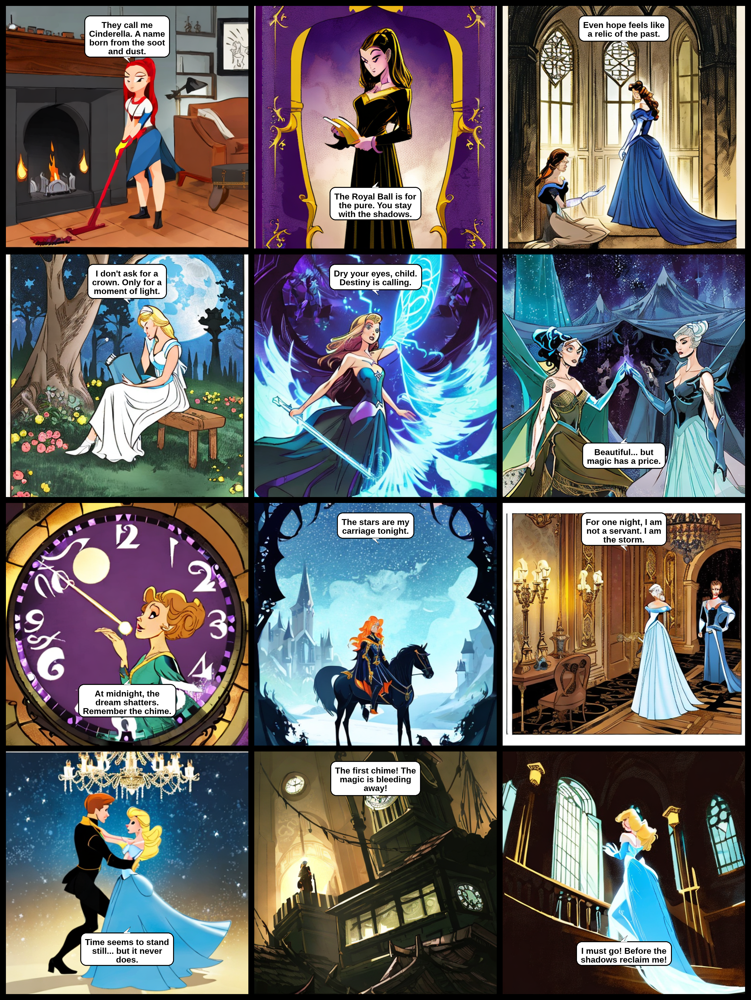

In [28]:
generate_and_assemble_comic(PANELS_DATA_Cinderella)

In [30]:
accuracy_report = get_panel_accuracy("/content/63b9757f-bb42-4dae-aa89-fd797d7aec4f.png", PANELS_DATA_Cinderella, grid_size=(4, 3))

config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

Loading weights:   0%|          | 0/398 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

CLIPModel LOAD REPORT from: openai/clip-vit-base-patch32
Key                                  | Status     |  | 
-------------------------------------+------------+--+-
vision_model.embeddings.position_ids | UNEXPECTED |  | 
text_model.embeddings.position_ids   | UNEXPECTED |  | 

Notes:
- UNEXPECTED	:can be ignored when loading from different task/architecture; not ok if you expect identical arch.


preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

The image processor of type `CLIPImageProcessor` is now loaded as a fast processor by default, even if the model checkpoint was saved with a slow processor. This is a breaking change and may produce slightly different outputs. To continue using the slow processor, instantiate this class with `use_fast=False`. 


tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

Panel 1: Score 29.58 | Good
Panel 2: Score 34.93 | Excellent
Panel 3: Score 32.11 | Excellent
Panel 4: Score 33.79 | Excellent
Panel 5: Score 30.04 | Excellent
Panel 6: Score 27.55 | Good
Panel 7: Score 36.17 | Excellent
Panel 8: Score 29.60 | Good
Panel 9: Score 33.14 | Excellent
Panel 10: Score 36.11 | Excellent
Panel 11: Score 27.59 | Good
Panel 12: Score 31.32 | Excellent
Panel 13: Score 20.20 | Needs Revision
Panel 14: Score 21.39 | Needs Revision
Panel 15: Score 20.05 | Needs Revision
Panel 16: Score 21.45 | Needs Revision
